In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import ydata_profiling as pp
import warnings
warnings.filterwarnings("ignore")

In [2]:
df = pd.read_csv(r"..\Data\Raw_data\UCI_Credit_Card.csv")
df.head(3)

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
0,1,20000.0,2,2,1,24,2,2,-1,-1,...,0.0,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0,1
1,2,120000.0,2,2,2,26,-1,2,0,0,...,3272.0,3455.0,3261.0,0.0,1000.0,1000.0,1000.0,0.0,2000.0,1
2,3,90000.0,2,2,2,34,0,0,0,0,...,14331.0,14948.0,15549.0,1518.0,1500.0,1000.0,1000.0,1000.0,5000.0,0


In [3]:
'''
Content
There are 25 variables:

ID: ID of each client
LIMIT_BAL: Amount of given credit in NT dollars (includes individual and family/supplementary credit
SEX: Gender (1=male, 2=female)
EDUCATION: (1=graduate school, 2=university, 3=high school, 4=others, 5=unknown, 6=unknown)
MARRIAGE: Marital status (1=married, 2=single, 3=others)
AGE: Age in years
PAY_0: Repayment status in September, 2005 (-1=pay duly, 1=payment delay for one month, 2=payment delay for two months, … 8=payment delay for eight months, 9=payment delay for nine months and above)
PAY_2: Repayment status in August, 2005 (scale same as above)
PAY_3: Repayment status in July, 2005 (scale same as above)
PAY_4: Repayment status in June, 2005 (scale same as above)
PAY_5: Repayment status in May, 2005 (scale same as above)
PAY_6: Repayment status in April, 2005 (scale same as above)
BILL_AMT1: Amount of bill statement in September, 2005 (NT dollar)
BILL_AMT2: Amount of bill statement in August, 2005 (NT dollar)
BILL_AMT3: Amount of bill statement in July, 2005 (NT dollar)
BILL_AMT4: Amount of bill statement in June, 2005 (NT dollar)
BILL_AMT5: Amount of bill statement in May, 2005 (NT dollar)
BILL_AMT6: Amount of bill statement in April, 2005 (NT dollar)
PAY_AMT1: Amount of previous payment in September, 2005 (NT dollar)
PAY_AMT2: Amount of previous payment in August, 2005 (NT dollar)
PAY_AMT3: Amount of previous payment in July, 2005 (NT dollar)
PAY_AMT4: Amount of previous payment in June, 2005 (NT dollar)
PAY_AMT5: Amount of previous payment in May, 2005 (NT dollar)
PAY_AMT6: Amount of previous payment in April, 2005 (NT dollar)
default.payment.next.month: Default payment (1=yes, 0=no)
Inspiration
'''

'\nContent\nThere are 25 variables:\n\nID: ID of each client\nLIMIT_BAL: Amount of given credit in NT dollars (includes individual and family/supplementary credit\nSEX: Gender (1=male, 2=female)\nEDUCATION: (1=graduate school, 2=university, 3=high school, 4=others, 5=unknown, 6=unknown)\nMARRIAGE: Marital status (1=married, 2=single, 3=others)\nAGE: Age in years\nPAY_0: Repayment status in September, 2005 (-1=pay duly, 1=payment delay for one month, 2=payment delay for two months, … 8=payment delay for eight months, 9=payment delay for nine months and above)\nPAY_2: Repayment status in August, 2005 (scale same as above)\nPAY_3: Repayment status in July, 2005 (scale same as above)\nPAY_4: Repayment status in June, 2005 (scale same as above)\nPAY_5: Repayment status in May, 2005 (scale same as above)\nPAY_6: Repayment status in April, 2005 (scale same as above)\nBILL_AMT1: Amount of bill statement in September, 2005 (NT dollar)\nBILL_AMT2: Amount of bill statement in August, 2005 (NT dol

### Approach: The classical machine learning tasks like Data Exploration, Data Cleaning, Feature Engineering, Model Building and Model Testing. Try out different machine learning algorithms that’s best fit for the above case

#### Data Exploration

In [4]:
df.info()   # All are int and float type
            # No null values
'''
ID column is unnecessary
should change PAY_0 to PAY_1
Lets rename "default.payment.next.month" to "DEFAULT"
'''

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30000 entries, 0 to 29999
Data columns (total 25 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   ID                          30000 non-null  int64  
 1   LIMIT_BAL                   30000 non-null  float64
 2   SEX                         30000 non-null  int64  
 3   EDUCATION                   30000 non-null  int64  
 4   MARRIAGE                    30000 non-null  int64  
 5   AGE                         30000 non-null  int64  
 6   PAY_0                       30000 non-null  int64  
 7   PAY_2                       30000 non-null  int64  
 8   PAY_3                       30000 non-null  int64  
 9   PAY_4                       30000 non-null  int64  
 10  PAY_5                       30000 non-null  int64  
 11  PAY_6                       30000 non-null  int64  
 12  BILL_AMT1                   30000 non-null  float64
 13  BILL_AMT2                   300

'\nID column is unnecessary\nshould change PAY_0 to PAY_1\nLets rename "default.payment.next.month" to "DEFAULT"\n'

In [5]:
df.drop("ID", axis=1, inplace =True)
df.rename(columns={'PAY_0': 'PAY_1', 'default.payment.next.month':'DEFAULT'},inplace=True)

In [9]:
pp.ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [6]:
profile = pp.ProfileReport(df, title="Pandas Profiling Report")
profile.to_file("..\Templates\profilereport.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [30]:
'''
There are duplicate values.

Numeric	21
Categorical	3

"Education" and "Marriage" and "PAY_x" columns has some abnormal values, different from dataset description

Default values highly imbalanced.

Some features are highly correlated, they may indicate the behaviour of the person interms of PAY, BILL amount and Bill Payment
'''

'\nThere are duplicate values.\n\nNumeric\t21\nCategorical\t3\n\n"Education" and "Marriage" and "PAY_x" columns has some abnormal values, different from dataset description\n\nDefault values highly imbalanced.\n\nSome features are highly correlated, they may indicate the behaviour of the person interms of PAY, BILL amount and Bill Payment\n'

### Data Cleaning

In [6]:
df.drop_duplicates(inplace=True)   #Dropped Duplicates

In [7]:
cat= ["EDUCATION", "MARRIAGE", "SEX"]
def values(column):
    for i in column :
        print(df[i].value_counts(),"\n")

values(cat)

'''SEX: Gender (1=male, 2=female)
EDUCATION: (1=graduate school, 2=university, 3=high school, 4=others, 5=unknown, 6=unknown)
MARRIAGE: Marital status (1=married, 2=single, 3=others)'''

2    14019
1    10563
3     4915
5      280
4      123
6       51
0       14
Name: EDUCATION, dtype: int64 

2    15945
1    13643
3      323
0       54
Name: MARRIAGE, dtype: int64 

2    18091
1    11874
Name: SEX, dtype: int64 



'SEX: Gender (1=male, 2=female)\nEDUCATION: (1=graduate school, 2=university, 3=high school, 4=others, 5=unknown, 6=unknown)\nMARRIAGE: Marital status (1=married, 2=single, 3=others)'

In [8]:
df["EDUCATION"].replace([0,5,6],4, inplace=True)
df["MARRIAGE"].replace(0,3, inplace=True)

In [9]:
values(cat)  # It is fine now.

2    14019
1    10563
3     4915
4      468
Name: EDUCATION, dtype: int64 

2    15945
1    13643
3      377
Name: MARRIAGE, dtype: int64 

2    18091
1    11874
Name: SEX, dtype: int64 



In [10]:
for i in range(1,7):
    df[f"PAY_{i}"].replace([0,-2],-1, inplace=True)

In [11]:
for i in range(1,7):
    print(df[f"PAY_{i}"].value_counts(),"\n")


'''
(-1=pay duly,
1=payment delay for one month,
2=payment delay for two months,
…
8=payment delay for eight months,
9=payment delay for nine months and above)
'''

-1    23169
 1     3667
 2     2666
 3      322
 4       76
 5       26
 8       19
 6       11
 7        9
Name: PAY_1, dtype: int64 

-1    25528
 2     3926
 3      326
 4       99
 1       28
 5       25
 7       20
 6       12
 8        1
Name: PAY_2, dtype: int64 

-1    25753
 2     3819
 3      240
 4       75
 7       27
 6       23
 5       21
 1        4
 8        3
Name: PAY_3, dtype: int64 

-1    26456
 2     3159
 3      180
 4       68
 7       58
 5       35
 6        5
 1        2
 8        2
Name: PAY_4, dtype: int64 

-1    26998
 2     2626
 3      178
 4       83
 7       58
 5       17
 6        4
 8        1
Name: PAY_5, dtype: int64 

-1    26887
 2     2766
 3      184
 4       48
 7       46
 6       19
 5       13
 8        2
Name: PAY_6, dtype: int64 



'\n(-1=pay duly,\n1=payment delay for one month,\n2=payment delay for two months,\n…\n8=payment delay for eight months,\n9=payment delay for nine months and above)\n'

In [12]:
def count_plot(column_list):
    for i in column_list:
        plt.figure(figsize=(12,5))
        ax = sns.countplot(data = df, x = i , hue="DEFAULT")
        

        # add count values to bars
        for p in ax.patches:
            ax.annotate(format(p.get_height(), '.0f'), 
                        (p.get_x() + p.get_width() / 2., p.get_height()), 
                        ha = 'center', va = 'center', 
                        xytext = (0, 10), 
                        textcoords = 'offset points')

        # customize the plot
        plt.title(f'Countplot of {i}', fontsize=16)
        plt.xticks(fontsize=12)
        plt.yticks(fontsize=12)
        plt.show()

In [13]:
cat

['EDUCATION', 'MARRIAGE', 'SEX']

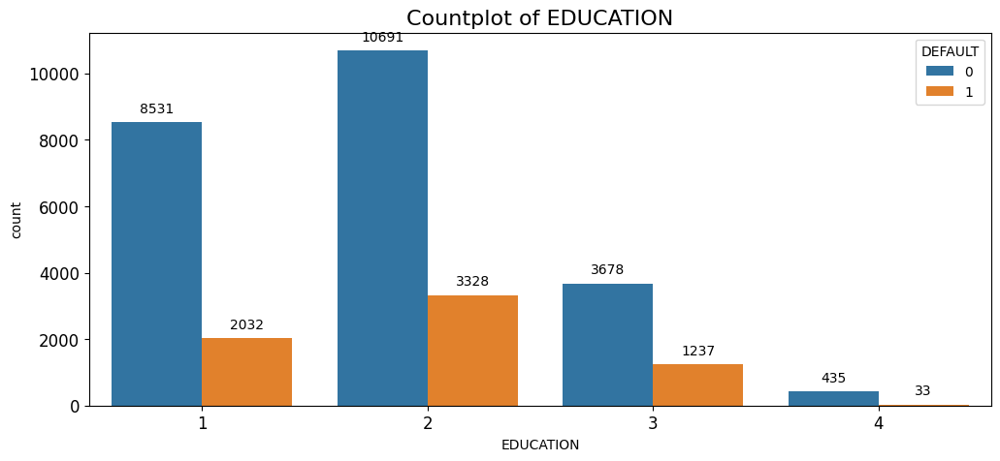

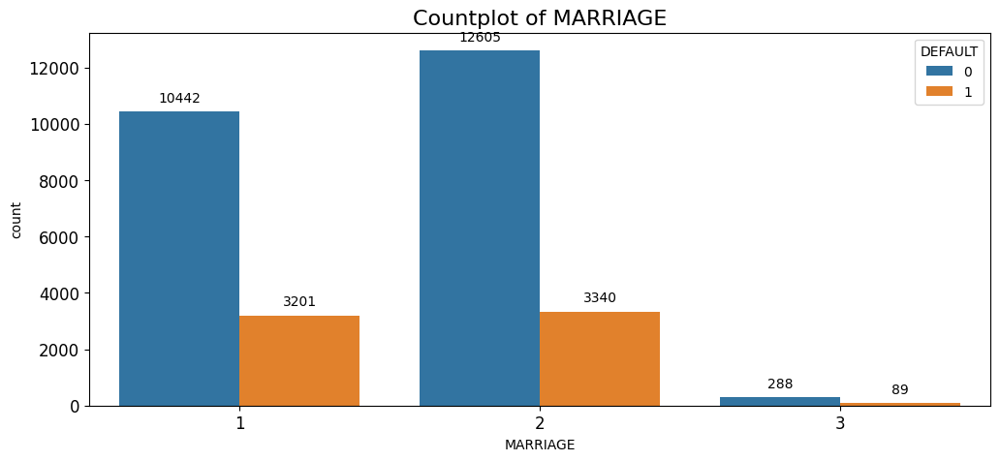

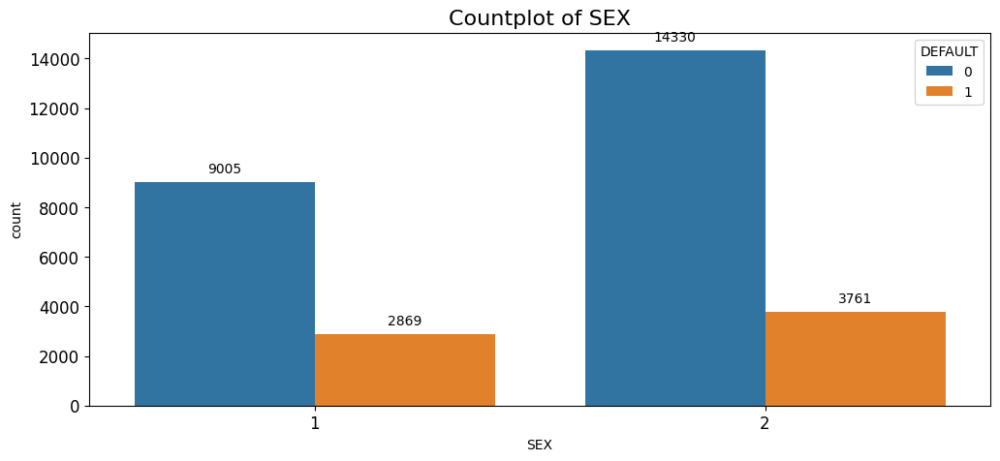

In [14]:
count_plot(cat)

From the above plots:

1. Males are more likely to default than Females

2. Education level with less than Graduate, univeristy level are more likely to default.

3. Marriage Status : Single are comparatively default more than MArried.

#### Feature Engineering

Feature engineering involves various steps such as data cleaning, data preprocessing, feature selection, feature scaling, and feature transformation. It can include techniques such as encoding categorical variables, imputing missing values, normalizing or scaling features, creating new features by combining existing ones, or reducing the dimensionality of the feature space.

In [15]:
df.columns

Index(['LIMIT_BAL', 'SEX', 'EDUCATION', 'MARRIAGE', 'AGE', 'PAY_1', 'PAY_2',
       'PAY_3', 'PAY_4', 'PAY_5', 'PAY_6', 'BILL_AMT1', 'BILL_AMT2',
       'BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6', 'PAY_AMT1',
       'PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6', 'DEFAULT'],
      dtype='object')

We need all the columns. though some numeric columns like PAY_s, BILL_AMTs etc are correlated, they are necessary to predict our target

Since our dataset is imbalanced, lets try to balance it.

In ProfileReport, we have seen heatmap for correlation, Lets see Variation Inflation Factor to check multicollearity of features.

In [16]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

# Calculate VIF for each feature
features = df.drop("DEFAULT", axis=1)
vif = pd.DataFrame()
vif['Feature'] = features.columns
vif['VIF'] = [variance_inflation_factor(features.values, i) for i in range(len(features.columns))]

# Print the VIF dataframe
print(vif)

      Feature        VIF
0   LIMIT_BAL   3.637961
1         SEX   9.156652
2   EDUCATION   7.372952
3    MARRIAGE   6.372818
4         AGE  11.147204
5       PAY_1   2.292429
6       PAY_2   3.225076
7       PAY_3   2.988229
8       PAY_4   3.631594
9       PAY_5   4.279789
10      PAY_6   3.069259
11  BILL_AMT1  20.760468
12  BILL_AMT2  38.103695
13  BILL_AMT3  31.733972
14  BILL_AMT4  29.417274
15  BILL_AMT5  35.875352
16  BILL_AMT6  21.373750
17   PAY_AMT1   1.901637
18   PAY_AMT2   2.378112
19   PAY_AMT3   1.895429
20   PAY_AMT4   1.791766
21   PAY_AMT5   1.850485
22   PAY_AMT6   1.270347


In [17]:
X= df.drop("DEFAULT",axis=1)
y=df["DEFAULT"]

In [18]:
from imblearn.over_sampling import SMOTE
from collections import Counter

print('Original dataset shape %s' % Counter(y))

sm= SMOTE()
X_res,y_res = sm.fit_resample(X,y)

print('Resampled dataset shape %s' % Counter(y_res))

Original dataset shape Counter({0: 23335, 1: 6630})
Resampled dataset shape Counter({1: 23335, 0: 23335})


In [20]:
from sklearn.preprocessing import StandardScaler
scale = StandardScaler()

X_scaled = scale.fit_transform(X_res)

array([ 2.000e+04,  2.000e+00,  2.000e+00,  1.000e+00,  2.400e+01,
        2.000e+00,  2.000e+00, -1.000e+00, -1.000e+00, -1.000e+00,
       -1.000e+00,  3.913e+03,  3.102e+03,  6.890e+02,  0.000e+00,
        0.000e+00,  0.000e+00,  0.000e+00,  6.890e+02,  0.000e+00,
        0.000e+00,  0.000e+00,  0.000e+00])

In [21]:
import pickle

# save the scaler object to a file
path = '..\Models\scaler.pkl'
with open(path, 'wb') as f:
    pickle.dump(scale, f)


In [34]:
# #load the scaler object from file
# with open('scaler.pkl', 'rb') as f:
#     scaler = pickle.load(f)

# # use the scaler object to transform new data
# c = scaler.transform([X_res.values[0]])


In [20]:
X.columns

Index(['LIMIT_BAL', 'SEX', 'EDUCATION', 'MARRIAGE', 'AGE', 'PAY_1', 'PAY_2',
       'PAY_3', 'PAY_4', 'PAY_5', 'PAY_6', 'BILL_AMT1', 'BILL_AMT2',
       'BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6', 'PAY_AMT1',
       'PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6'],
      dtype='object')

In [21]:
X_cleaned = pd.DataFrame(X_scaled, columns= X.columns)
y_cleaned = pd.DataFrame(y_res, columns=["DEFAULT"])

In [22]:
cleaned_data= pd.concat([X_cleaned,y_cleaned],axis=1,ignore_index=False)

In [23]:
cleaned_data

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,DEFAULT
0,-1.067662,0.985999,0.349810,-0.889338,-1.298055,1.807971,1.889545,-0.530789,-0.468738,-0.430297,...,-0.664005,-0.655320,-0.647128,-0.339107,-0.218078,-0.284863,-0.299474,-0.304047,-0.282104,1
1,-0.270995,0.985999,0.349810,1.054345,-1.071492,-0.712330,1.889545,-0.530789,-0.468738,-0.430297,...,-0.613355,-0.598983,-0.592892,-0.339107,-0.202123,-0.220571,-0.226830,-0.304047,-0.153811,1
2,-0.509995,0.985999,0.349810,1.054345,-0.165240,-0.712330,-0.570495,-0.530789,-0.468738,-0.430297,...,-0.442166,-0.411579,-0.388524,-0.229833,-0.176471,-0.220571,-0.226830,-0.229725,0.038628,0
3,-0.828662,0.985999,0.349810,-0.889338,0.174605,-0.712330,-0.570495,-0.530789,-0.468738,-0.430297,...,-0.225714,-0.183116,-0.155715,-0.195136,-0.149845,-0.207713,-0.219565,-0.224597,-0.217958,0
4,-0.828662,-1.014200,0.349810,-0.889338,2.440235,-0.712330,-0.570495,-0.530789,-0.468738,-0.430297,...,-0.339861,-0.343126,-0.328949,-0.195136,1.628413,0.358050,0.354325,-0.252839,-0.238549,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46665,0.047671,-1.014200,-1.080507,-0.889338,-0.278522,1.807971,1.069531,1.146276,1.235265,1.358661,...,0.503668,0.681231,0.687259,-0.335671,0.026835,-0.280932,0.243818,-0.304047,-0.152450,1
46666,-1.147329,-1.014200,0.349810,1.054345,-1.637900,0.127770,-0.570495,-0.530789,-0.468738,-0.430297,...,-0.515203,-0.500198,-0.484618,-0.255378,-0.194208,-0.262167,-0.274706,-0.272821,-0.269861,1
46667,0.578088,-1.014200,-1.080507,1.054345,-0.505085,1.807971,0.249518,-0.530789,0.383264,0.464182,...,2.411663,2.678289,2.718223,0.164031,0.483813,0.178100,0.431720,-0.215070,0.453042,1
46668,1.959672,-1.014200,0.349810,-0.889338,0.061323,-0.712330,-0.570495,0.307743,-0.468738,-0.430297,...,-0.555474,-0.608581,-0.604529,-0.193342,-0.253270,0.137871,-0.126250,-0.149610,-0.115747,1


In [25]:
import os

# if not os.path.exists('my_custom_folder'):
#     os.makedirs('my_custom_folder')

# save the cleaned_data DataFrame to a CSV file in the custom folder
cleaned_data.to_csv('..\Data\cleanedData\CleanData.csv', index=False)
